# Vascular cell state marker genes
### An organotypic atlas of human vascular cells

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.io
import matplotlib.pyplot as plt
import os
import anndata
import seaborn as sns
import harmonypy as hm


%matplotlib inline

In [2]:
sc.settings.set_figure_params(dpi=300,fontsize=15)

In [3]:
adata_orig = sc.read_h5ad('/rds/general/user/snb20/projects/cardiac_single_cell_biology/live/Endothelial_datasets/paper_revision/final_ec_july2024.h5ad')

In [4]:
adata = adata_orig

In [5]:
adata

AnnData object with n_obs × n_vars = 34433 × 30021
    obs: 'orig.ident', 'Sample', 'Winkler_annotation_ec', 'Winkler_annotation_mural', 'Winkler_annotation_mural_fine', 'donor', 'kit', 'study', 'organ_uni', 'Winkler_annotation', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Winkler_broad_annotation', 'id', 'organ', 'sorting', 'location', 'age', 'gender', 'dissociation', 'scrublet_score', 'doublet_bh_pval', 'published_annotation', 'HCA', 'published_annotation_skin', 'batch', 'cell_ontology_class', 'free_annotation', 'compartment', 'age2', 'barcode', 'concat_sample_no', 'Population ', 'hospital_id', 'Organ', 'Cell_category', 'Predicted_labels_CellTypist', 'Majority_voting_CellTypist', 'Majority_voting_CellTypist_high', 'doublet_pv

In [10]:
adata2 = adata.copy()

In [11]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
     'adip_cap_ec': 'cap_ec',
     'ven_ec_2': 'ven_ec_2',
     'aerocyte_ec': 'cap_ec',
     'aorta_coronary_ec': 'aorta_coronary_ec',
     'art_ec_1': 'art_ec_1',
     'art_ec_2': 'art_ec_2',
     'brain_art_ec': 'brain_art_ec',
     'blood_brain_barrier_ec': 'cap_ec',
     'brain_ven_ec': 'brain_ven_ec',
     'cap_ec': 'cap_ec',
     'endometrium_cap_ec': 'cap_ec',
     'glomeruli_ec': 'cap_ec',
     'kidney_art_ec': 'kidney_art_ec',
     'kidney_cap_ec': 'cap_ec',
     'myo_cap_ec': 'cap_ec',
     'pericentral_cap_ec': 'cap_ec',
     'periportal_cap_ec': 'cap_ec',
     'pul_art_ec': 'pul_art_ec',
     'pul_cap_ec': 'cap_ec',
     'pul_tip_cap_ec': 'cap_ec',
     'pul_ven_ec': 'pul_ven_ec',
     'endocardial_ec': 'endocardial_ec',
     'spleen_art_ec': 'spleen_art_ec',
     'ven_ec_1': 'ven_ec_1',
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata2.obs['art_ven'] = adata2.obs['ann_ec_states'].map(cluster2annotation).astype('category')

In [12]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
     'adip_cap_ec': 'adip_cap_ec',
     'ven_ec_2': 'ven_ec',
     'aerocyte_ec': 'aerocyte_ec',
     'aorta_coronary_ec': 'art_ec',
     'art_ec_1': 'art_ec',
     'art_ec_2': 'art_ec',
     'brain_art_ec': 'art_ec',
     'blood_brain_barrier_ec': 'blood_brain_barrier_ec',
     'brain_ven_ec': 'ven_ec',
     'cap_ec': 'cap_ec',
     'endometrium_cap_ec': 'endometrium_cap_ec',
     'glomeruli_ec': 'glomeruli_ec',
     'kidney_art_ec': 'art_ec',
     'kidney_cap_ec': 'kidney_cap_ec',
     'myo_cap_ec': 'myo_cap_ec',
     'pericentral_cap_ec': 'pericentral_cap_ec',
     'periportal_cap_ec': 'periportal_cap_ec',
     'pul_art_ec': 'art_ec',
     'pul_cap_ec': 'pul_cap_ec',
     'pul_tip_cap_ec': 'pul_tip_cap_ec',
     'pul_ven_ec': 'ven_ec',
     'endocardial_ec': 'endocardial_ec',
     'spleen_art_ec': 'art_ec',
     'ven_ec_1': 'ven_ec',
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata2.obs['cap'] = adata2.obs['ann_ec_states'].map(cluster2annotation).astype('category')

In [18]:
# sc.pl.umap(adata, color = "ann_merged_final", groups = ["aerocyte_ec","pul_cap_ec","pul_tip_cap_ec","periportal_cap_ec","pericentral_cap_ec","kidney_cap_ec","glomeruli_ec","cap_ec","endometrium_cap_ec","myometrium_cap_ec","myo_cap_ec","adip_cap_ec"])

art_ven_markers_2 = {
    'pan_ec': ["PECAM1","CDH5","VWF","EGFL7","CLDN5"],
    'arterial_ec': ["SEMA3G","GJA5","DLL4"],
    'large_art_ec': ["OMD","OGN","EFEMP1"],
    'shared': ["SULF1","BGN","ELN","COL8A1"],
    'art_ec_1': ["GUCY1A1","SSTR1","ABI3BP"],
    'art_ec_2': ["NEBL","GPIHBP1","ALPL","VEGFA"],
    'brain_art_ec': ["DKK2","ROR1","EFNA5","SLC4A4"],
    'kidney_art_ec': ["SLC6A6","PI16","CHRM3","KCNN3"],
    'spleen_art_ec': ["SERPINA5","GP9","NOX5","NR5A1"],
    'pul_art_ec': ["CLDN10","NPR3","VIPR1","NOS1"],
    
    'capillary_ec': ["RGCC","GPIHBP1","CA4"],

    'venous_ec': ["ACKR1","POSTN","PLVAP","SELP"],
    'ven_ec_2': ["SELE","ICAM4","CSF3","PCDH19"],
    'pul_ven_ec': ["PLA1A","PTGDS","HDAC9","IL7R"],
    'brain_ven_ec': ["ADGRL3","SH3RF3","CDH23","TRPM6"],
    'endocardial_ec': ["NPR3","SMOC1","INHBA","CGNL1"],
    
#    'aerocyte_ec': ["HPGD","EDNRB","SOSTDC1"],
#    'pul_cap_ec': ["FCN3","IL7R","FOXF1"],
#    'pul_cap_tip_ec': ["PGF","ESM1","ANGPT2","CXCR4","CYTL1"],
#    'periportal_cap_ec': ["NFATC1","CLEC14A","MGP","SPARCL1","TM4SF1","ID1"],
#    'pericentral_cap_ec': ["CLEC1B","CLEC4G","CLEC4M","CD4"],
#    'kidney_cap_ec': ["IGFBP5","CEACAM1"],
#    'glomeruli_ec': ["ESM1","SOST","MEG3","EHD3"],
#    'endometrum_cap_ec': ["APCDD1","SNCA","HOXD9"],
#   'myometrium_cap_ec': ["SERPINE1","CXCL8","ELL2","TNIP2"],
#    'myo_cap_ec': ["FABP4","MEOX2","TCF15"],
#    'adip_cap_ec': ["LIPE","ACACB","PPARG"],
#    'blood-brain-barrier_ec': ["MFSD2A","SLCO1A2","SLC38A3","SLC7A8","SLC7A11"],
#    'littoral_ec': ["CD8A","PROX1","LYVE1","KAZN","SERPINA5","NR5A1","PCSK6","LSP1"],
#    'lymphatic_ec': ["PROX1","LYVE1","CCL21","MMRN1","TFF3","PDPN"],
#    'other': ["PTPRC","PDGFRA","ACTA2","TTN","GPAM"]

}

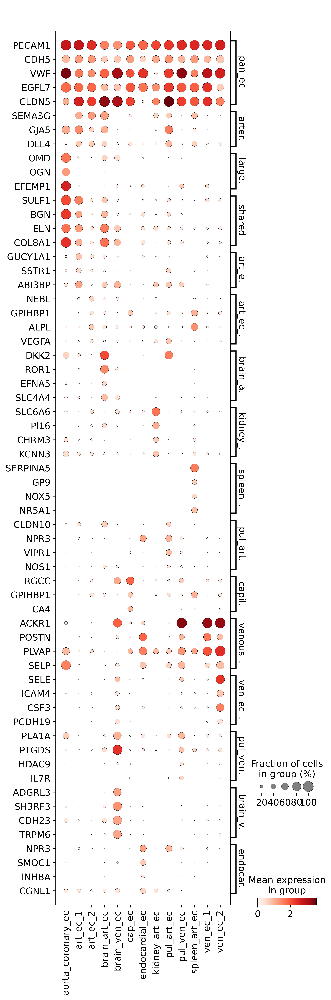

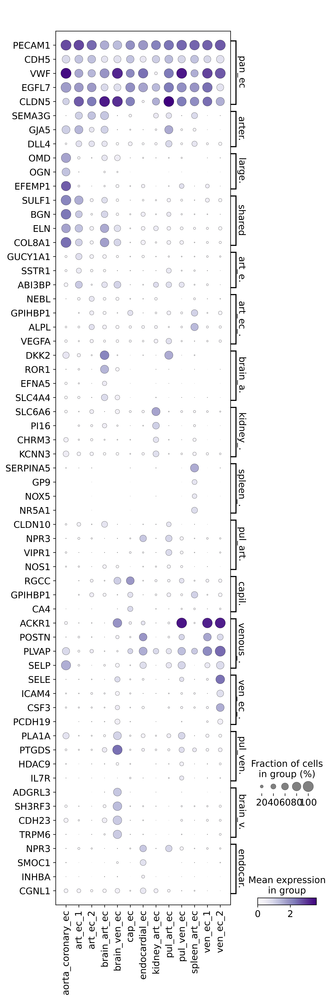

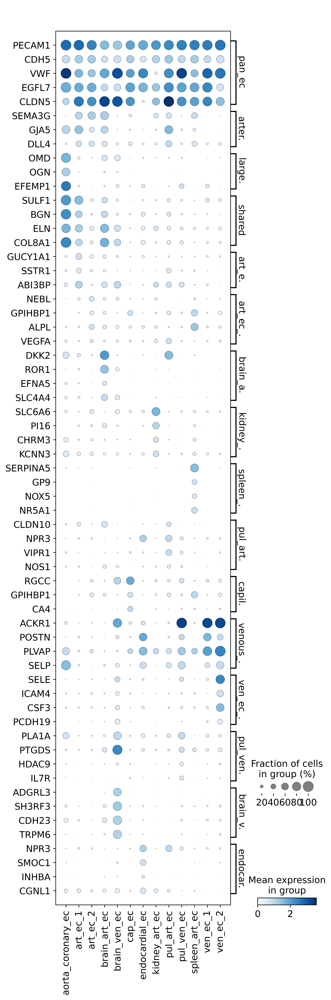

In [19]:
sc.pl.dotplot(adata2, art_ven_markers_2, "art_ven", cmap = 'Reds', swap_axes = True)
sc.pl.dotplot(adata2, art_ven_markers_2, "art_ven", cmap = 'Purples', swap_axes = True)
sc.pl.dotplot(adata2, art_ven_markers_2, "art_ven", cmap = 'Blues', swap_axes = True)

In [20]:
# sc.pl.umap(adata, color = "ann_merged_final", groups = ["aerocyte_ec","pul_cap_ec","pul_tip_cap_ec","periportal_cap_ec","pericentral_cap_ec","kidney_cap_ec","glomeruli_ec","cap_ec","endometrium_cap_ec","myometrium_cap_ec","myo_cap_ec","adip_cap_ec"])

cap_markers = {
    'pan_ec': ["PECAM1","CDH5","VWF","EGFL7","CLDN5"],
    'arterial_ec': ["SEMA3G","GJA5","DLL4"],
    #'large_art_ec': ["OMD","OGN","EFEMP1"],
    #'shared': ["SULF1","BGN","ELN","COL8A1"],
    #'art_ec_1': ["GUCY1A1","SSTR1","ABI3BP"],
    #'art_ec_2': ["NEBL","GPIHBP1","ALPL","VEGFA"],
    #'brain_art_ec': ["DKK2" ,"ROR1","EFNA5"],
    #'kidney_art_ec': ["SLC6A6","PI16","CHRM3","KCNN3"],
    #'spleen_art_ec': ["SERPINA5","GP9","NOX5","NR5A1"],
    #'pul_art_ec': ["CLDN10","NPR3","VIPR1","NOS1"],

    'capillary_ec': ["RGCC","GPIHBP1","CA4"],

    'aerocyte_ec': ["HPGD","EDNRB","SOSTDC1"],
    'pul_cap_ec': ["FCN3","IL7R","FOXF1"],
    'pul_cap_tip_ec': ["PGF","ESM1","ANGPT2","CXCR4","CYTL1"],
    'periportal_cap_ec': ["NFATC1","CLEC14A","MGP","SPARCL1","TM4SF1","ID1"],
    'pericentral_cap_ec': ["CLEC1B","CLEC4G","CLEC4M","CD4"],
    'kidney_cap_ec': ["IGFBP5","CEACAM1"],
    'glomeruli_ec': ["ESM1","SOST","MEG3","EHD3"],
    'endometrum_cap_ec': ["APCDD1","SNCA","HOXD9"],
#   'myometrium_cap_ec': ["SERPINE1","CXCL8","ELL2","TNIP2"],
    'myo_cap_ec': ["FABP4","MEOX2","TCF15"],
    'adip_cap_ec': ["LIPE","ACACB","PPARG"],
    'blood-brain-barrier_ec': ["MFSD2A","SLCO1A2","SLC38A3","SLC7A8","SLC7A11"],
    
#    'littoral_ec': ["CD8A","PROX1","LYVE1","KAZN","SERPINA5","NR5A1","PCSK6","LSP1"],
#    'lymphatic_ec': ["PROX1","LYVE1","CCL21","MMRN1","TFF3","PDPN"],
#    'other': ["PTPRC","PDGFRA","ACTA2","TTN","GPAM"]    
    
    'venous_ec': ["ACKR1","POSTN","PLVAP","SELP"],
    #'ven_ec_2': ["SELE","ICAM4","CSF3","PCDH19"],
    #'pul_ven_ec': ["PLA1A","PTGDS","HDAC9","IL7R"],
    #'brain_ven_ec': ["ADGRL3","IPCEF1","NMUR2"],
    #'endocardial_ec': ["SMOC1","NPR3","INHBA","CGNL1"],

}

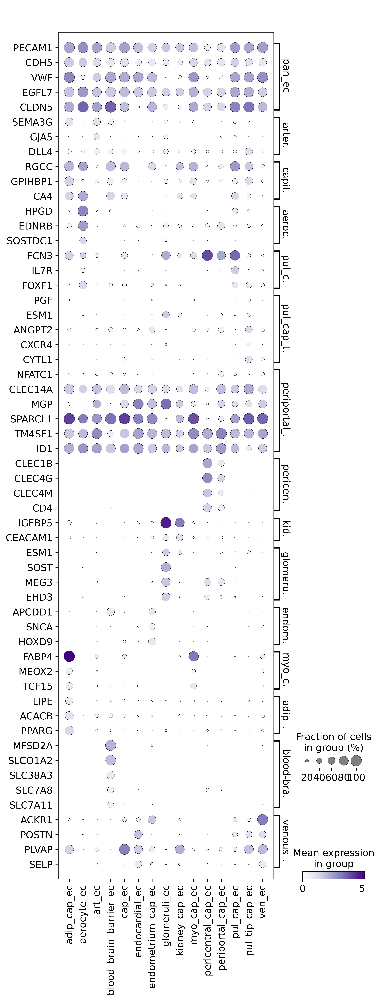

In [21]:
sc.pl.dotplot(adata2, cap_markers, "cap", cmap = 'Purples', swap_axes = True)

In [5]:
adata_orig = sc.read_h5ad('/rds/general/user/snb20/projects/cardiac_single_cell_biology/live/Endothelial_datasets/paper_revision/lec_240520_lat_10_layer_1.h5ad')

In [6]:
adata = adata_orig

In [7]:
adata

AnnData object with n_obs × n_vars = 4232 × 30021
    obs: 'orig.ident', 'Sample', 'Winkler_annotation_ec', 'Winkler_annotation_mural', 'Winkler_annotation_mural_fine', 'donor', 'kit', 'study', 'organ_uni', 'Winkler_annotation', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_rb', 'pct_counts_rb', 'Winkler_broad_annotation', 'id', 'organ', 'sorting', 'location', 'age', 'gender', 'dissociation', 'scrublet_score', 'doublet_bh_pval', 'published_annotation', 'HCA', 'published_annotation_skin', 'batch', 'cell_ontology_class', 'free_annotation', 'compartment', 'age2', 'barcode', 'concat_sample_no', 'Population ', 'hospital_id', 'Organ', 'Cell_category', 'Predicted_labels_CellTypist', 'Majority_voting_CellTypist', 'Majority_voting_CellTypist_high', 'doublet_pva

In [40]:
adata.obs["ann_lec_states"] = adata.obs['ann_lec_states'].cat.reorder_categories(["cap_lec","bridging_lec","ceiling_lec","floor_lec","perifollicular_sinus_lec","valve_up_lec","valve_down_lec"])

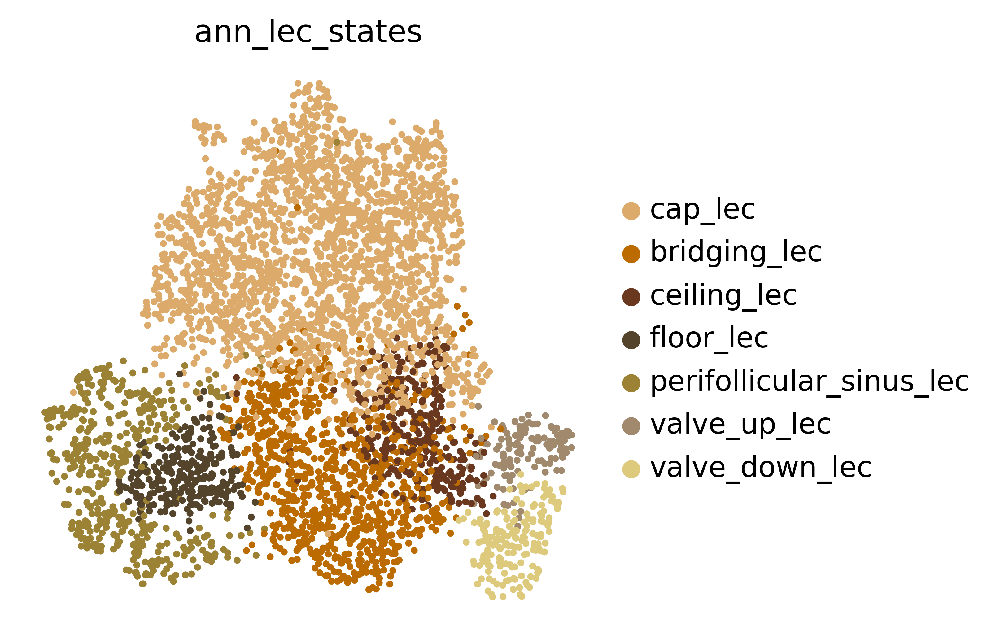

In [41]:
sc.pl.umap(adata, color = 'ann_lec_states', palette =['#dcab6b', # 'cap',  g
                         '#bb6b00', # 'b', g
                         '#6a381f', # 'c', y
                         '#54442b', # 'f', y 
                         '#9B8235', # 'pfs', g
                         '#A0896D', # 'vup', gy
                         '#ddca7d', # 'vdown'
                         ], frameon = False)

In [12]:
lec_markers = {
    'lec': ["PECAM1","PROX1","CCL21","MMRN1","TFF3","LAYN"],
    'lec_cap': ["LYVE1","PDPN","RELN","LOX"],
    'lymph_node': ["NTS","ACKR3","TMOD1","EEF1G","PLA1A","C7"],
    'blec': ["ACKR4","SCUBE2","PCDH15"],
    'clec': ["TMEM100","THBS4","ADAMTS1"],
    'flec_pfslec': ["CCL14","CLEC4M","CLEC4G"],
    'flec': ["CXCL3","PLVAP","THY1"],
    'pfslec': ["MARCO","CD209","LGMN"],
    'vlec_up': ["NEO1","CD24","ADAMTS6"],
    'vlec_down': ["GJA4","HGF","SCG3"],

}

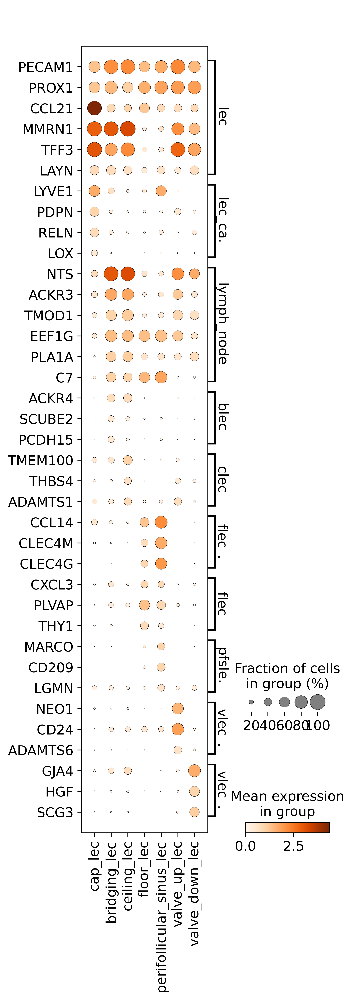

In [13]:
sc.pl.dotplot(adata, lec_markers, "ann_lec_states", cmap = 'Oranges', swap_axes = True)

In [5]:
adata_orig = sc.read_h5ad('/rds/general/user/snb20/projects/cardiac_single_cell_biology/live/Endothelial_datasets/paper_revision/final_mural_july2024.h5ad')

In [6]:
adata = adata_orig.copy()

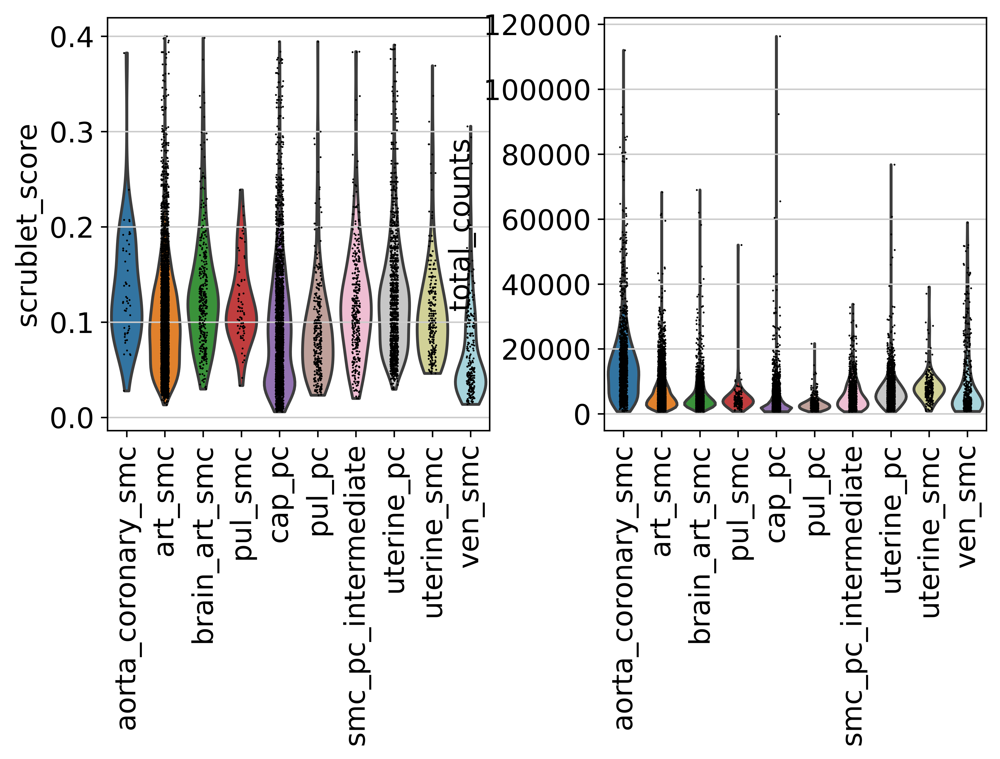

In [7]:
sc.pl.violin(adata, keys = ["scrublet_score","total_counts"], groupby = 'ann_mural_final_3', ncols = 2, rotation = 90, multipanel = True)

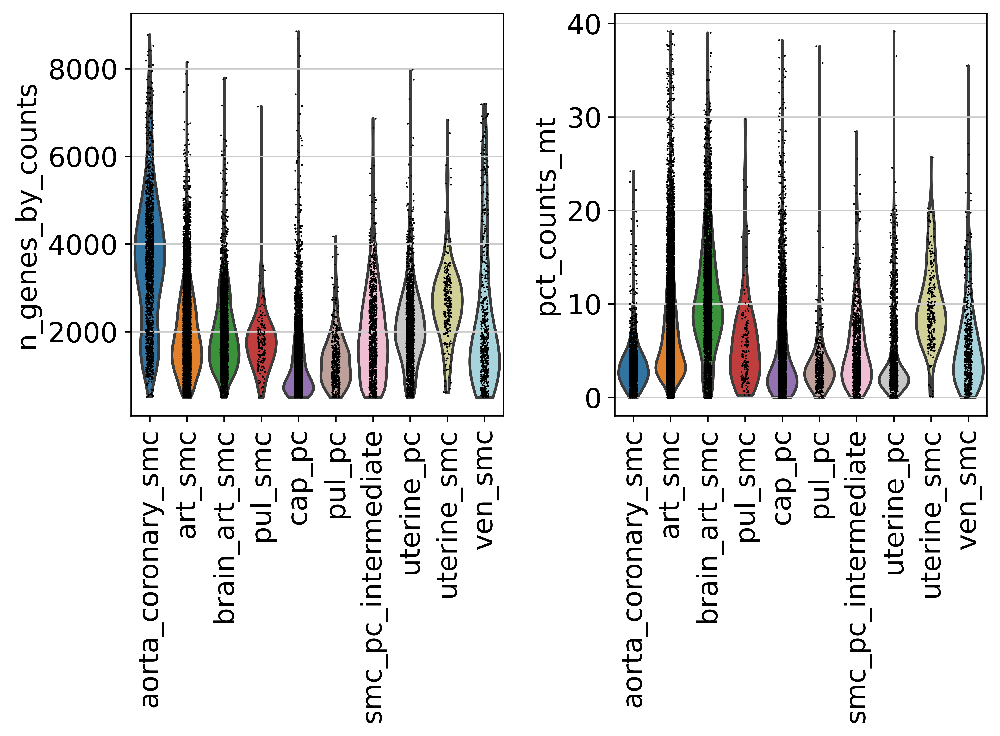

In [8]:
sc.pl.violin(adata, keys = ["n_genes_by_counts","pct_counts_mt"], groupby = 'ann_mural_final_3', ncols = 2, rotation = 90, multipanel = True)

In [9]:
# sc.pl.umap(adata, color = "ann_merged_final", groups = ["aerocyte_ec","pul_cap_ec","pul_tip_cap_ec","periportal_cap_ec","pericentral_cap_ec","kidney_cap_ec","glomeruli_ec","cap_ec","endometrium_cap_ec","myometrium_cap_ec","myo_cap_ec","adip_cap_ec"])

mural_markers = {
    'mural': ["PDGFRB","ACTA2","NOTCH3"],
    'vSMC': ["MYH11","CNN1","TAGLN","PLN",],
    'pericyte': ["KCNJ8","ABCC9","NDUFA4L2","RGS5","HIGD1B","AGT"],
    'aorta_coronary_smc': ["ELN","OMD","OGN"],
    'art_smc': ["RERGL","CASQ2","KCNAB1"],
    'brain_art_smc': ["PDE4D","MUSTN1","SIK3","SOX5"],
    'pul_smc': ["ELN","LTBP2","FST"],
    'uterine_smc': ["HOPX","APCDD1","NREP"],
    'pul_pc': ["PTN","KCNK3","LAMC3"],
    'pul_shared': ["TCF21","EGFL6","PERP"],
    'uterine_pc': ["LY6E","IFI6","LUM","IFI27"],
    'smc_pc_intermediate': ["STEAP4","FGF7","PROCR","CLSTN2"],
    'ven_smc': ["PRUNE2","HMCN2","CHRDL1","FLNC","CYFIP2"],

}

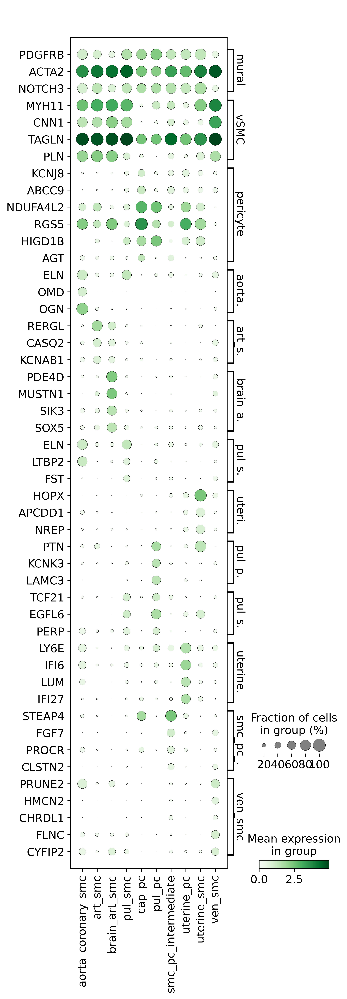

In [10]:
sc.pl.dotplot(adata, mural_markers, "ann_mural_final_3", swap_axes = True, color_map = 'Greens', use_raw = False)

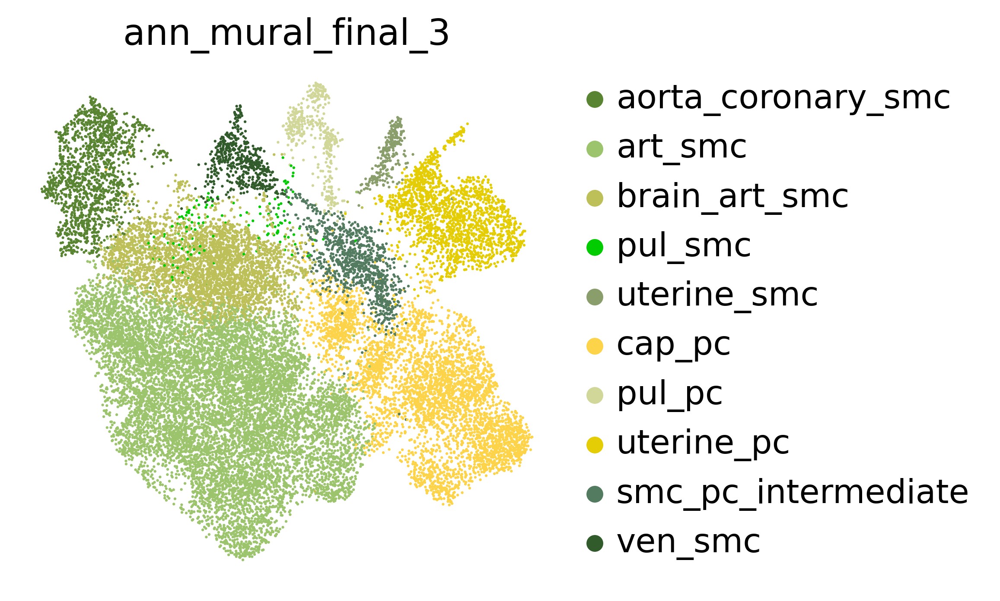

In [56]:
sc.pl.umap(adata2, color = 'ann_mural_final_3', 
                         palette =['#598532', # 'aorta_coronary_smc',  g
                         '#9BC46C', # 'arterial_smc', g
                         '#BDBF58', # 'brain_art_smc', g
                         '#00CC00',#pul_art_ec         
                         '#8A9E6B', # 'uterine_smc', gy
                         '#FDD349', # 'capillary_pc', y
                         '#D1D699', # 'pulmonary_pc', y
                         '#E4CD05', # 'uterine_pc',  y
                         '#527B5F', # 'smc_pc_intermediate', g
                         '#315B2B', # 'ven_smc' g
                                  ], frameon = False)